## Speech Recognition

If you know how neural machine translation works, you might guess that we could simply feed sound recordings into a neural network and train it to produce text.

<img src="1.png" width=800>

That’s the holy grail of speech recognition with deep learning, but we aren’t quite there yet (at least at the time that I wrote this — I bet that we will be in a couple of years).
The big problem is that speech varies in speed. One person might say “hello!” very quickly and another person might say “heeeelllllllllllllooooo!” very slowly, producing a much longer sound file with much more data. Both both sound files should be recognized as exactly the same text — “hello!” Automatically aligning audio files of various lengths to a fixed-length piece of text turns out to be pretty hard.
To work around this, we have to use some special tricks and extra precessing in addition to a deep neural network. Let’s see how it works!

**Sound**

sound is transmitted as waves. How do we turn sound waves into numbers? Let’s use this sound clip of me saying “eight”:

Sound waves are one-dimensional. At every moment in time, they have a single value based on the height of the wave. Let’s zoom in on one tiny part of the sound wave and take a look:



In [7]:
import glob
import os
import numpy as np
def ls(path, filesOnly=False, pattern=False):
    """
    list file(s) in @path. 
    If @filesOnly is True, directories are omitted. 
    If @pattern is True, the function will treat the path as 
    a pattern and list all files and directories that satisfy it.
    """
    if pattern:
        return glob.glob(path)
    if filesOnly:
        files = [ f for f in os.listdir(path) if is_file(os.path.join(path,f)) ]
    else:
        files = [ f for f in os.listdir(path)]
    return files

In [23]:
dataset = "data/free-spoken-digit-dataset/recordings/"
eightdataset = ls("%s/8_*.wav" % (dataset), pattern=True)
jacksoneight = '%s/8_jackson_0.wav' % dataset

In [24]:
# opening wav file
import wave
spf = wave.open(jacksoneight,'r')

In [25]:
spf.getframerate()

8000

In [26]:
#Extract Raw Audio from Wav File
signal = spf.readframes(-1)
signal = np.fromstring(signal, 'Int16')

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:3: DeprecationWarning: Numeric-style type codes are deprecated and will result in an error in the future.
  This is separate from the ipykernel package so we can avoid doing imports until
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:3: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  This is separate from the ipykernel package so we can avoid doing imports until


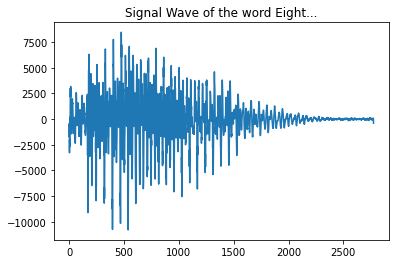

In [27]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.figure(1)
plt.title('Signal Wave of the word Eight...')
plt.plot(signal)
plt.show()

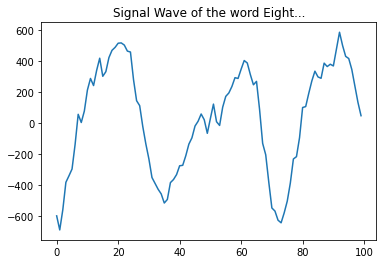

In [28]:
plt.figure(1)
plt.title('Signal Wave of the word Eight...')
plt.plot(signal[2000:2100])
plt.show()

### Pre-Processing our Sampled Sound Data

We now have an array of numbers with each number representing the sound wave’s amplitude at 1/16,000th of a second intervals.

We could feed these numbers right into a neural network. But trying to recognize speech patterns by processing these samples directly is difficult. Instead, we can make the problem easier by doing some pre-processing on the audio data.

Let’s start by grouping our sampled audio into 20-millisecond-long chunks.

In [29]:
s = 20
chunksize = int(s*spf.getframerate()/1000) # to millisecond
new_size = int(signal.shape[0]/chunksize)*chunksize
signal2 = signal[:new_size]
groups = signal2.reshape((-1,chunksize))

In [95]:
groups[0]

array([-1693,  -432, -1706, -3279, -2030, -2671, -2664, -2151,   196,
        -312,  1182,  3006,  2154,  2967,  3188,  1884,  1129,  1251,
        -432, -1043,  -556, -1431, -1328,  -399,  -212,    23,  1146,
        1327,  1429,  1978,  1749,  1471,  1581,   979,   393,   293,
        -211,  -911,  -986, -1134, -1420, -1343,  -970,  -921,  -460,
        -126,   -74,   178,   123,  -168,  -489,  -901, -1428, -1813,
       -2167, -2170, -2353, -1709, -1230,  -688,   222,   901,  1789,
        2063,  2473,  2588,  2318,  2046,  1375,  1046,   384,  -148,
        -423,  -626,  -609,  -519,  -110,   290,   640,   983,  1426,
        1583,  1314,  1110,   896,   143,  -381,  -796, -1235, -1561,
       -1689, -1447, -1509, -1088,  -414,  -705,   342,   578,   388,
         921,   859,   795,   153,   290,  -258, -1231, -1254, -2110,
       -2327, -2272, -2531, -2102, -1254, -1017,  -117,   819,  1361,
        1670,  2170,  2321,  1886,  1846,  1240,   689,   379,  -225,
        -406,  -479,

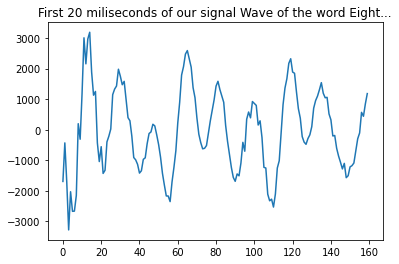

In [31]:
plt.figure(1)
plt.title('First 20 miliseconds of our signal Wave of the word Eight...')
plt.plot(groups[0])
plt.show()

This recording is only 1/50th of a second long. But even this short recording is a complex mish-mash of different frequencies of sound. There’s some low sounds, some mid-range sounds, and even some high-pitched sounds sprinkled in. But taken all together, these different frequencies mix together to make up the complex sound of human speech.

To make this data easier for a neural network to process, we are going to break apart this complex sound wave into it’s component parts. We’ll break out the low-pitched parts, the next-lowest-pitched-parts, and so on. Then by adding up how much energy is in each of those frequency bands (from low to high), we create a fingerprint of sorts for this audio snippet.


Imagine you had a recording of someone playing a C Major chord on a piano. That sound is the combination of three musical notes— C, E and G — all mixed together into one complex sound. We want to break apart that complex sound into the individual notes to discover that they were C, E and G. This is the exact same idea.


We do this using a mathematic operation called a Fourier transform. It breaks apart the complex sound wave into the simple sound waves that make it up. Once we have those individual sound waves, we add up how much energy is contained in each one.

In [97]:
from scipy.fftpack import fft, ifft,fftshift
f_groups = np.abs(fft(groups))
f_groups[0]

array([  3503.        ,   3553.42560985,   6220.45125727,  70045.28125153,
         9692.17788214,  20581.878096  ,  26065.99070597,   6516.42829041,
        26879.54484018, 111847.80972081,  34198.60333421,  17594.00839087,
        28878.48518373,  12083.80058827,   6616.75349533,   2814.00167263,
          973.37503235,   2058.62249911,   1433.56563396,   1252.99714443,
         1003.72054081,   1635.39469831,   1332.07430094,   1498.92762014,
         1401.01668694,   1240.21264636,   1127.16031076,   1244.14662004,
          683.6357452 ,   1329.54573449,   1017.41601291,   1014.76863605,
         1060.67881374,    952.19080446,    252.77485267,    878.88304553,
         1025.66930666,    282.03754333,    853.51313077,    714.54400769,
          965.2445286 ,   2360.48097261,   4060.05870978,   2139.42263956,
         1234.54947731,   2411.42378355,   1180.58980833,   3002.34647167,
         3915.24048385,   5187.41521911,   7855.64193157,   7997.20729271,
        13966.14437519,  

The end result is a score of how important each frequency range is, from low pitch (i.e. bass notes) to high pitch. Each number below represents how much energy was in each 50hz band of our 20 millisecond audio clip:

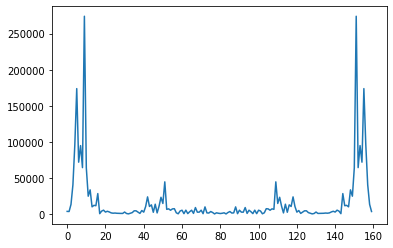

In [33]:
index = 4
plt.plot(f_groups[index])

But this is a lot easier to see when you draw this as a chart:

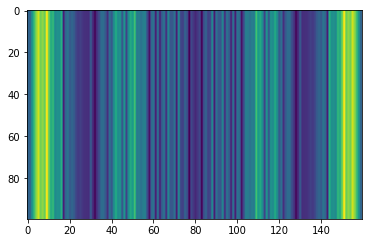

In [34]:
data = np.repeat(f_groups[index],100).reshape(-1,100)
plt.imshow(np.log(data).T)

If we repeat this process on every 20 millisecond chunk of audio, we end up with a spectrogram (each column from left-to-right is one 20ms chunk):


A spectrogram is cool because you can actually see musical notes and other pitch patterns in audio data. A neural network can find patterns in this kind of data more easily than raw sound waves. So this is the data representation we’ll actually feed into our neural network.

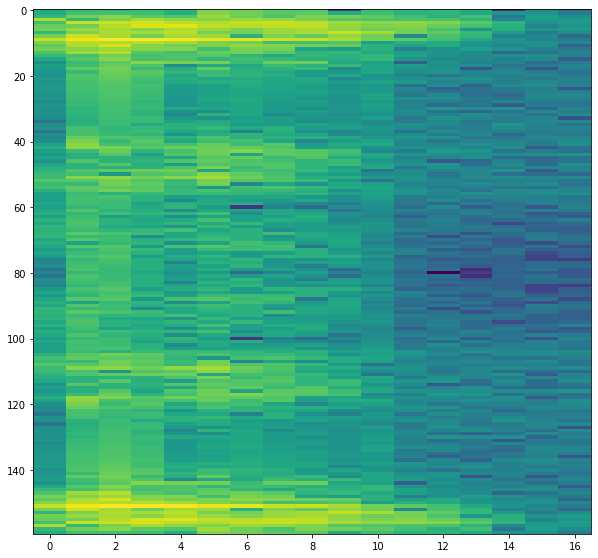

In [35]:
plt.imshow(np.log(f_groups).T, aspect=0.1)
plt.gcf().set_size_inches((10,10))

### Spectrum of other speakers

In [36]:
import glob
import warnings
warnings.filterwarnings('ignore')
def load_spectrum(dataset,chunklength = 20):
    spectrums = []
    for f in dataset:
        spf = wave.open(f,'r')
        signal = spf.readframes(-1)
        signal = np.fromstring(signal, 'Int16')
        chunksize = int(chunklength*spf.getframerate()/1000) # to millisecond
        new_size = int(signal.shape[0]/chunksize)*chunksize
        groups = signal[:new_size].reshape((-1,chunksize))
        f_groups = np.abs(fft(groups))
        spectrums.append(f_groups)
    return np.array(spectrums)

In [39]:
# load the word eight
spectrums_eight = load_spectrum(eightdataset)

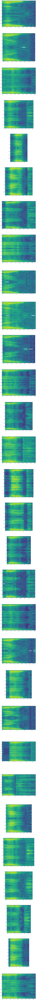

In [55]:
# plot the word eight spoken by different speakers
samples = 30
fig, ax = plt.subplots(nrows=samples)#spectrums_eight.shape[0])
fig.set_size_inches((10,10*samples))
for i in range(samples):
    ax[i].imshow(np.log(spectrums_eight[i].T),aspect=0.1)

In [56]:
# load the word seven spoken by different speakers
spectrums_seven = load_spectrum(ls("%s/7_*.wav" % dataset,pattern=True))

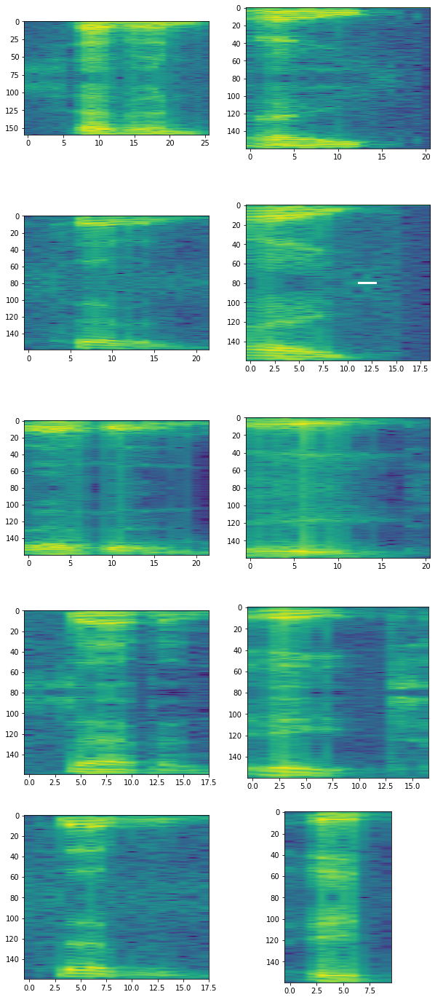

In [58]:
# plot word seven and eight side by side
samples = 5
fig, ax = plt.subplots(nrows=samples,ncols=2)
fig.set_size_inches((10,5*samples))
min_shape = min([samples,samples])
for i in range(min_shape):
    ax[i,0].imshow(np.log(spectrums_seven[i].T),aspect=0.1)
    ax[i,1].imshow(np.log(spectrums_eight[i].T),aspect=0.1)

## Frequency Domain

You can think of an image as a signal. A signal that comes in 2D. If that is the case, then according to Jean Baptiste Joseph Fourier's crazy idea, any periodic function (signal) can be rewritten as a weighted sum of sines and cosines of different frequencies. 

   
### A sum of sines

Our building block:

$ A*sin(\omega*x+\varphi)$

Add enough of them to get any signla f(x) you want

**Example**

<center>
<font size="2px">
            $A*\sum_{k=1}^{\infty}{\frac{1}{k}}sin(2*\pi*k*t) $
</font>
</center>

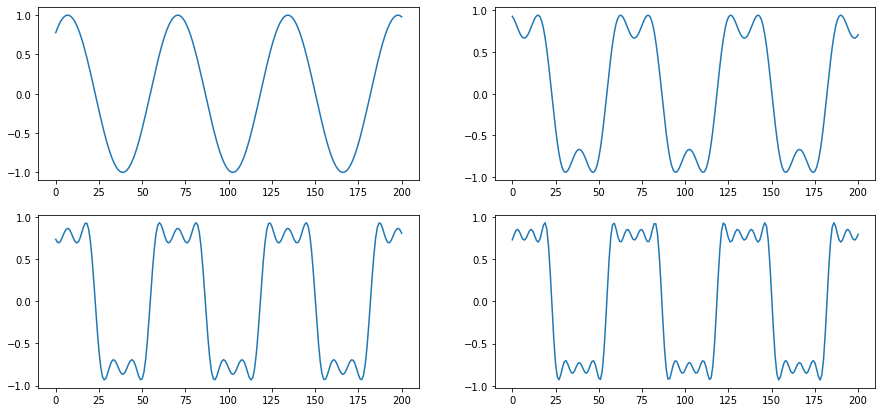

In [35]:
at = lambda t,k: + (1.0/k)*np.sin(2*np.pi*k*t)
Ampl = 1
x = np.linspace(np.pi, 2*np.pi, 201)
fig, ax = plt.subplots(2,2)
fig.set_size_inches(15,7)
pis = [(0,0),(0,1),(1,0),(1,1)]
for i in range(1,5):
    y = np.array([at(xi,1) for xi in x])
    for k in range(1,i):      
        y += Ampl*np.array([at(xi,2*k+1) for xi in x])
    ax[pis[i-1][0],pis[i-1][1]].plot(y)

Text(0.5, 0, 'frequency')

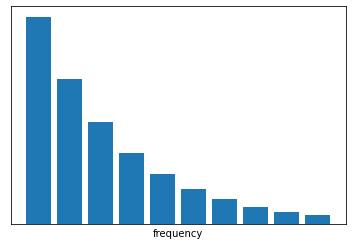

In [36]:
plt.bar(np.arange(10),[0.7**x for x in np.arange(10)])
ax = plt.gca()
ax.xaxis.set_major_locator(plt.NullLocator())
ax.yaxis.set_major_locator(plt.NullLocator())
ax.set_xlabel("frequency")

<a href="https://betterexplained.com/articles/an-interactive-guide-to-the-fourier-transform/">Better explained here</a>

### Fourier Transform

Represent the signal as an infinite weighted sum of an infinite number of sinusoids:



<img src="imgs/fig_2.png" />

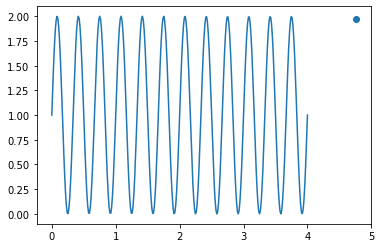

In [37]:
# time function
f = 3
fx = lambda t:  1+np.sin(2*f*np.pi*t)
# angular function
fw = lambda f,t: fx(t)*np.exp(2*np.pi*1.j*f*t)
# period 4
x = np.linspace(0, 4, 300)
# time function
y = fx(x)
plt.plot(x,y)
speed = 0.21
d = 1/speed
plt.scatter([d],[fx(d)])

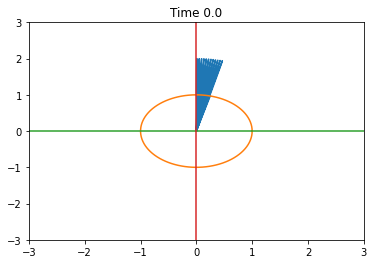

In [38]:
# showing time domain periodic function in circular wrapping
import matplotlib.animation

fig, ax = plt.subplots()
ax.set_xlim(-3,3)
ax.set_ylim(-3,3)
l, = ax.plot([], [])  
theta = np.linspace(0, 2*np.pi, 100)
factor = 1
r = factor*np.sqrt(1.0)
x1 = r*np.cos(theta)
x2 = r*np.sin(theta)
ax.plot(x1, x2)
ax.plot([-3,3],[0,0])
ax.plot([0,0],[-3,3])
def animate(i):
    f = (i+1)/100
    x = np.linspace(0, 4, 300)
    yi = [fw(f,t) for t in x]
    real = [k.real for k in yi]
    imag = [k.imag for k in yi]
    l.set_data(imag, real)
    ax.set_title(f"Time {float(i/100)}")

ani = matplotlib.animation.FuncAnimation(fig, animate, 
                                        frames=np.arange(0,300))
from IPython.display import HTML
HTML(ani.to_jshtml())

## Convolution

Think of it this way — an image is just a multi-dimensional matrix. Our image has a width (# of columns) and a height (# of rows), just like a matrix.

But unlike the traditional matrices you may have worked with back in grade school, images also have a depth to them — the number of channels in the image. For a standard RGB image, we have a depth of 3 — one channel for each of the Red, Green, and Blue channels, respectively.

Given this knowledge, we can think of an image as a big matrix and kernel or convolutional matrix as a tiny matrix that is used for blurring, sharpening, edge detection, and other image processing functions.


<img src="imgs/convolutions_kernel_sliding.jpg" width=200/>

For more explanation go to <a href="https://www.pyimagesearch.com/2016/07/25/convolutions-with-opencv-and-python/">pyimagesearch</a>

In [56]:
from scipy.signal import convolve2d
from scipy import signal
def convolve(img,kernal,mode="constant"):
    return normalize_img(convolve2d(img,kernal))
def convolve_color(im, window):
    """
    Convolves im with window, over all three colour channels
    """
    ims = []
    for d in range(3):
        im_conv_d = normalize_img(np.real(convolve2d(im[:,:,d].astype(np.int), window, mode="same", boundary="symm")))
        ims.append(im_conv_d)
    im_conv = np.stack(ims, axis=2).astype("uint8")
    return im_conv

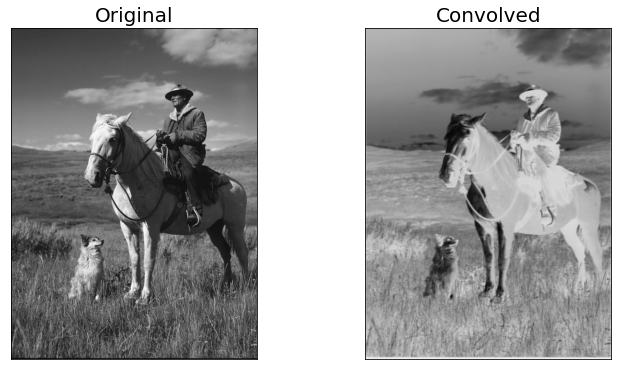

In [57]:
# Try random kernal. Run multiple times to observe
r_kernal = np.array([[-1,0,1],[-1,0,1],[-1,0,1]])
k = 5
r_kernal = np.random.randint(-k,k,k**2).reshape((k,k))
# reading parrot
imarray = imread(IMAGES.MAN,True)
# graying
imarray_gray = gray(imarray)
# convolving
imarray_con = convolve(imarray_gray,r_kernal)
plot_grid([imarray_gray,imarray_con],["Original","Convolved"])

In [58]:
# construct the Laplacian kernel used to detect edge-like
# regions of an image
laplacian = np.array((
    [0, 1, 0],
    [1, -4, 1],
    [0, 1, 0]), dtype="int")
# construct the Sobel x-axis kernel
sobelX = np.array((
 [-1, 0, 1],
 [-2, 0, 2],
 [-1, 0, 1]), dtype="int")
# construct the Sobel y-axis kernel
sobelY = np.array((
    [-1, -2, -1],
    [0, 0, 0],
    [1, 2, 1]), dtype="int")
# construct average blurring kernels used to smooth an image
smallBlur = np.ones((7, 7), dtype="float") * (1.0 / (7 * 7))
largeBlur = np.ones((21, 21), dtype="float") * (1.0 / (21 * 21))
# construct a sharpening filter
sharpen_1 = np.array((
    [0, -1, 0],
    [-1, 5, -1],
    [0, -1, 0]), dtype="int")
sharpen_15 = 1.5*sharpen_1
sharpen_2 = 2*sharpen_1

#emboss kernal
emboss = np.array([[-2,-1,0],[-1,1,1],[0,1,2]])
#edge schar kernal
edge_schar = np.array([[ -3-3j, 0-10j, +3 -3j], [-10+0j, 0+ 0j, +10+0j], [ -3+3j, 0+10j, +3 +3j]])

# DoG kernal
x = np.linspace(-10, 10, 15)
kernel_1d = np.exp(-0.005*x**2)
kernel_1d /= np.trapz(kernel_1d) # normalize the sum to 1
gauss_kernel1 = kernel_1d[:, np.newaxis] * kernel_1d[np.newaxis, :]
kernel_1d = np.exp(-5*x**2)
kernel_1d /= np.trapz(kernel_1d) # normalize the sum to 1
gauss_kernel2 = kernel_1d[:, np.newaxis] * kernel_1d[np.newaxis, :]
DoGKernel = gauss_kernel1[:, :] - gauss_kernel2[:, :]


# construct the kernel bank, a list of kernels we're going
# to applY
kernelBank = {
    "small_blur": smallBlur,
    "large_blur": largeBlur,
    "sharpen_1": sharpen_1,
    "sharpen_1.5": sharpen_15,
    "sharpen_2": sharpen_2,
    "laplacian": laplacian,
    "sobel_x": sobelX,
    "sobel_y": sobelY,
    "emboss": emboss,
    "edge_schar": edge_schar,
    "dog": DoGKernel
}

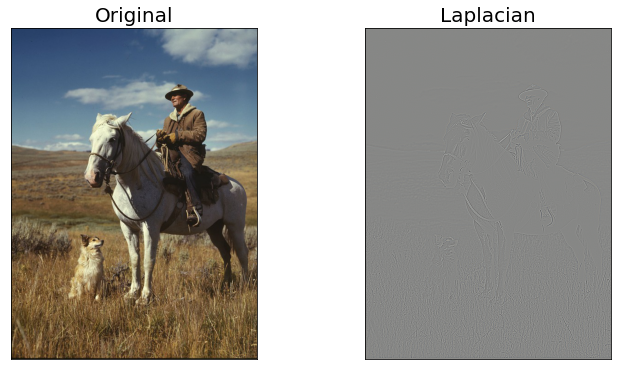

In [59]:
# laplacian
img = imarray
imarray_lapl = convolve_color(img,kernelBank["laplacian"])
plot_grid([img,imarray_lapl],["Original","Laplacian"])

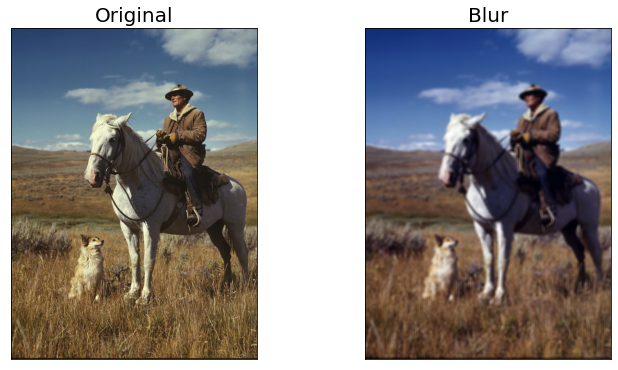

In [60]:
# small blur 
img = imarray
imarray_blur = convolve_color(img,kernelBank["small_blur"])
plot_grid([img,imarray_blur],["Original","Blur"])

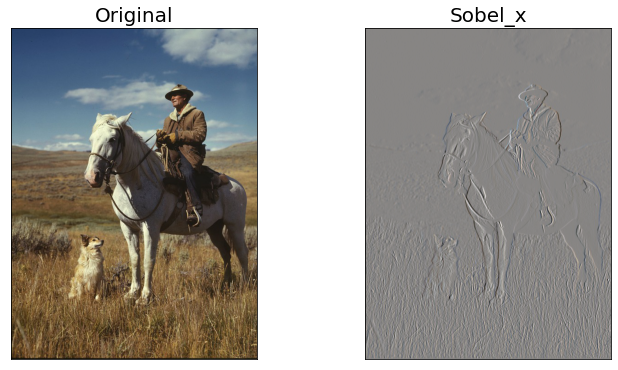

In [61]:
# sobel x
img = imarray
imarray_sobel_x = convolve_color(img,kernelBank["sobel_x"])
plot_grid([img,imarray_sobel_x],["Original","Sobel_x"])

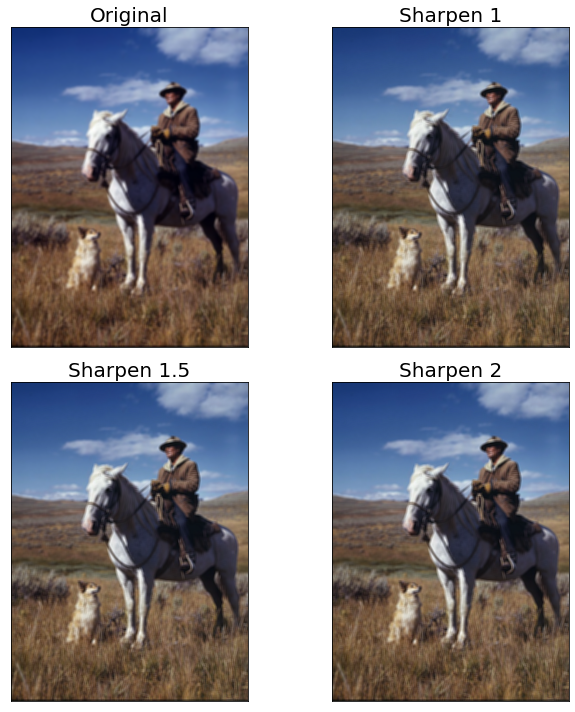

In [62]:
# sharpen
img = imarray_blur
imarray_sharp_1 = convolve_color(img,kernelBank["sharpen_1"])
imarray_sharp_15 = convolve_color(img,kernelBank["sharpen_1.5"])
imarray_sharp_2 = convolve_color(img,kernelBank["sharpen_2"])
plot_grid([img,imarray_sharp_1,imarray_sharp_15,imarray_sharp_2],["Original","Sharpen 1","Sharpen 1.5","Sharpen 2"])

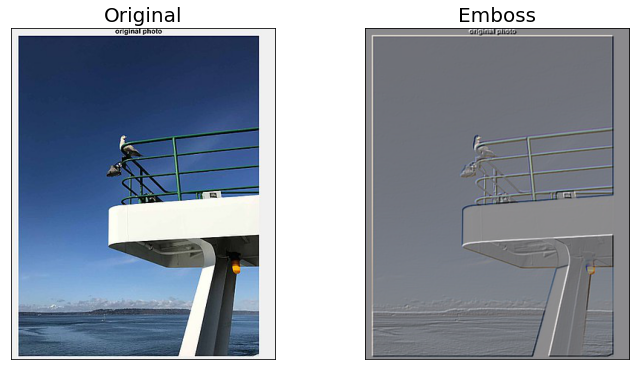

In [63]:
# emboss
img = imread(IMAGES.EMBOSS,True)
imarray_emboss = convolve_color(img,kernelBank["emboss"])
plot_grid([img,imarray_emboss],["Original","Emboss"])

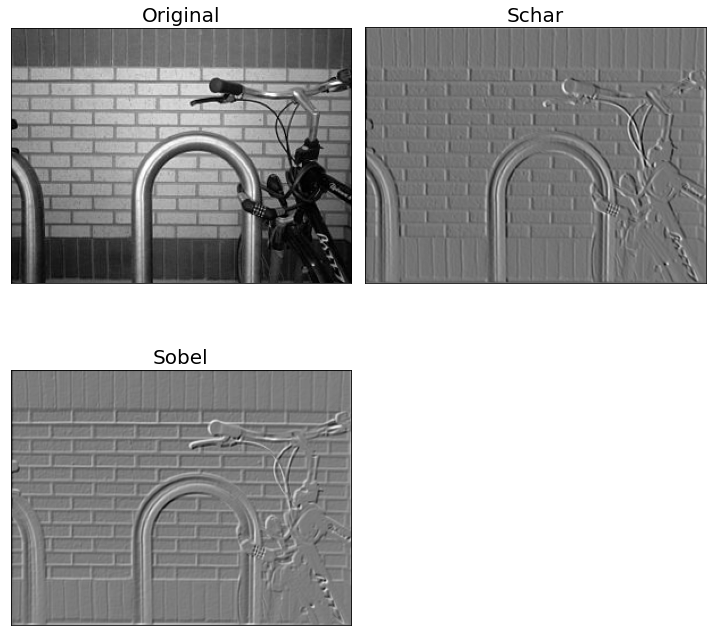

In [64]:
# schar
img = imread(IMAGES.BIKESGRAY,True)
imarray_schar = convolve(img,kernelBank["edge_schar"]).real
imarray_sobel_x = convolve(img,kernelBank["sobel_x"])
imarray_sobel_y = convolve(img,kernelBank["sobel_y"])
sobel_mag = grad_mag(imarray_sobel_x,imarray_sobel_y)
#sobel_mag[sobel_mag < 175] = 0
plot_grid([img,imarray_schar,sobel_mag],["Original","Schar","Sobel"])

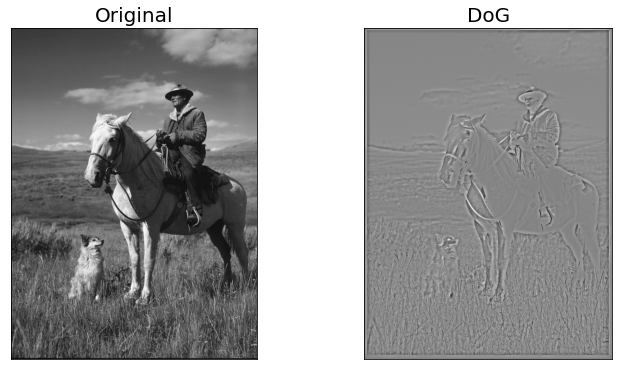

In [65]:
# DoG
img = imarray_gray
imarray_dog = convolve(img,kernelBank["dog"])
plot_grid([img,imarray_dog],["Original","DoG"])

## Convolutinal Neural Network

<img src="neuralnetwork.png" width=500/>
<img src="vggs.png" width=500/>

## Simple CNN to classify Seven vs Eight

To classify wether a spoken word is seven or eight using CNN, we need first to acquire spectrums as images

In [63]:
from numpy import asarray
from keras.preprocessing.image import img_to_array
from keras.applications.vgg16 import VGG16
from keras.layers import GlobalAveragePooling2D,Dense
from keras.models import Model
from PIL import Image

In [60]:
import io
def to_pil(figure,dpi=128):
    buf = io.BytesIO()
    figure.savefig(buf,dpi=dpi,format='jpeg',
    transparent=True,bbox_inches='tight',pad_inches=0)
    buf.seek(0)
    return Image.open(buf).resize((224,224))

def transform(data,labels=["Seven","Eight"]):
    imgs = []
    _labels = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            plt.imshow(np.log(data[i,j].T),aspect=0.1)
            plt.axis('off')
            plt.tick_params(axis='both', left='off', top='off', right='off', bottom='off', labelleft='off', labeltop='off', labelright='off', labelbottom='off')
            imgs.append(to_pil(plt.gcf()))
            _labels.append(labels[i])
    return imgs,_labels

In [65]:
samples = 20
data = np.append(np.expand_dims(spectrums_seven[:samples],axis=0),
                 np.expand_dims(spectrums_eight[:samples],axis=0),axis=0)

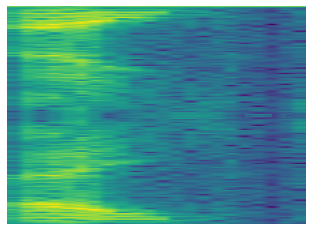

In [66]:
imgs,labels = transform(data)

In [67]:
imgs_array = [img_to_array(img) for img in imgs]
photos = asarray(imgs_array)
labels_names = labels
labels_onehot = np.array([[1,0] if l == "Seven" else [0,1] for l in labels_names])

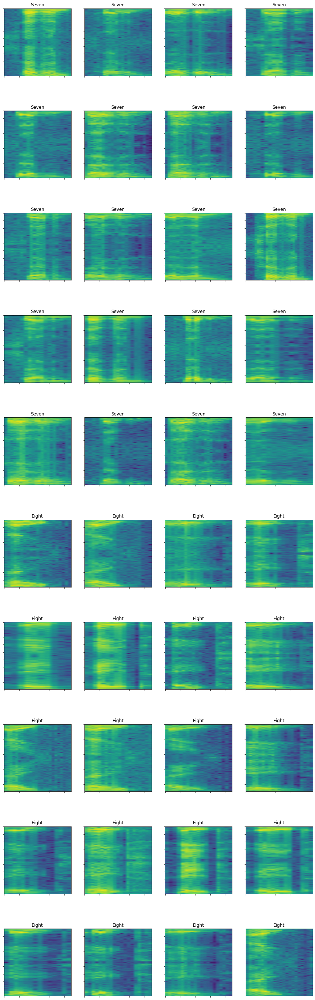

In [68]:
ncols = 4
nrows = int(len(imgs)/ncols)
fig, ax = plt.subplots(nrows=nrows, ncols=ncols)
fig.set_size_inches((15,nrows*5))
plt.axis('off')
plt.tick_params(axis='both', left='off', top='off', right='off', bottom='off', labelleft='off', labeltop='off', labelright='off', labelbottom='off')
for i,im in enumerate(imgs):
    ax[int(i/ncols),i%ncols].imshow(im)
    ax[int(i/ncols),i%ncols].xaxis.set_major_formatter(plt.NullFormatter())
    ax[int(i/ncols),i%ncols].yaxis.set_major_formatter(plt.NullFormatter())
    ax[int(i/ncols),i%ncols].set_title(labels[i])

In [86]:
!ls models/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5

models/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5


In [87]:
# load model
# if you have the model weights
base_model = VGG16(include_top=False,weights="models/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5",input_shape=(224,224,3))
# else download it
#base_model = VGG16(include_top=False,input_shape=(224,224,3))
# add a global spatial average pooling layer
x = base_model.output
x = GlobalAveragePooling2D()(x)
# let's add a fully-connected layer
x = Dense(1024, activation='relu')(x)
# and a logistic layer -- let's say we have 200 classes
predictions = Dense(2, activation='softmax')(x)

# this is the model we will train
model = Model(inputs=base_model.input, outputs=predictions)

# first: train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# compile the model (should be done *after* setting layers to non-trainable)
model.compile(optimizer='adam', loss='binary_crossentropy')

In [88]:
# selecting 70% for training 
train_index= np.random.choice(photos.shape[0],int(photos.shape[0]*0.7),replace=False)

In [89]:
model.fit(photos[train_index],labels_onehot[train_index],epochs=15)

Epoch 1/15
1/1 [==============================] - 3s 3s/step - loss: 1.8891
Epoch 2/15
1/1 [==============================] - 3s 3s/step - loss: 0.7296
Epoch 3/15
1/1 [==============================] - 3s 3s/step - loss: 1.2311
Epoch 4/15
1/1 [==============================] - 3s 3s/step - loss: 0.8298
Epoch 5/15
1/1 [==============================] - 3s 3s/step - loss: 0.4384
Epoch 6/15
1/1 [==============================] - 3s 3s/step - loss: 0.5405
Epoch 7/15
1/1 [==============================] - 3s 3s/step - loss: 0.6059
Epoch 8/15
1/1 [==============================] - 3s 3s/step - loss: 0.4617
Epoch 9/15
1/1 [==============================] - 3s 3s/step - loss: 0.2806
Epoch 10/15
1/1 [==============================] - 3s 3s/step - loss: 0.2432
Epoch 11/15
1/1 [==============================] - 3s 3s/step - loss: 0.3012
Epoch 12/15
1/1 [==============================] - 3s 3s/step - loss: 0.3175
Epoch 13/15
1/1 [==============================] - 3s 3s/step - loss: 0.2529
Epoch 14

In [90]:
model.save("models/sevenvseght.h5")
model.load_weights("models/sevenvseght.h5")

In [91]:
prediction = model.predict(photos)

In [92]:
prediction = ["Seven" if p == 0 else "Eight" for p in np.argmax(prediction,axis=1)]

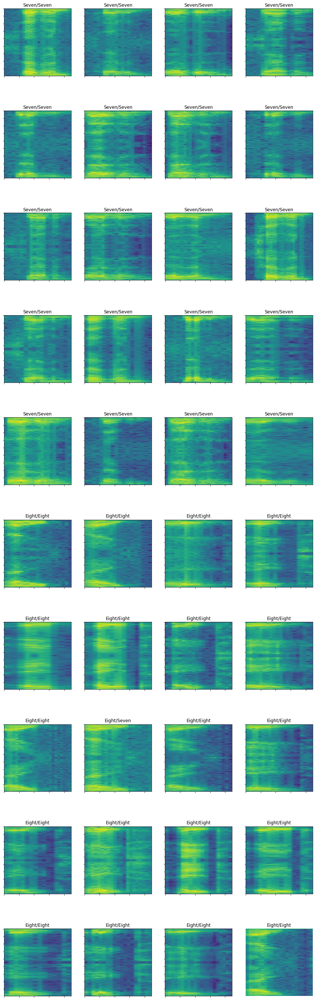

In [93]:
ncols = 4
nrows = int(len(imgs)/ncols)
fig, ax = plt.subplots(nrows=nrows, ncols=ncols)
fig.set_size_inches((15,nrows*5))
plt.axis('off')
plt.tick_params(axis='both', left='off', top='off', right='off', bottom='off', labelleft='off', labeltop='off', labelright='off', labelbottom='off')
for i,im in enumerate(imgs):
    ax[int(i/ncols),i%ncols].imshow(im)
    ax[int(i/ncols),i%ncols].xaxis.set_major_formatter(plt.NullFormatter())
    ax[int(i/ncols),i%ncols].yaxis.set_major_formatter(plt.NullFormatter())
    p = prediction[i]
    a = labels_names[i]
    ax[int(i/ncols),i%ncols].set_title('%s/%s' % (a,p))